# Semi-supervised surgery pipeline with SCANVI

In [124]:
print('here...')

here...


In [125]:
try:
    from nbproject import header
    header()
except ModuleNotFoundError:
    print("If you want to see the header with dependencies, please install nbproject - pip install nbproject")

If you want to see the header with dependencies, please install nbproject - pip install nbproject


In [126]:
import scvi
scvi.__version__

'0.19.0'

In [127]:
import os
os.chdir('../')
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)

In [128]:
import scanpy as sc
import torch
import matplotlib.pyplot as plt
import numpy as np
import gdown

from matplotlib import rcParams
rcParams['figure.facecolor'] = 'white'


In [129]:
import scarches as sca
from scarches.dataset.trvae.data_handling import remove_sparsity

In [130]:
sca

<module 'scarches' from '/home/rio/miniconda3/envs/scvi/lib/python3.10/site-packages/scarches/__init__.py'>

In [131]:
sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(dpi=200)
sc.set_figure_params(figsize=(4, 4))
torch.set_printoptions(precision=3, sci_mode=False, edgeitems=7)

### Set relevant anndata.obs labels and training length

Here we use the CelSeq2 and SS2 studies as query data and the other 3 studies as reference atlas.

In [132]:
condition_key = 'study'
condition_key = 'batch_donor_dataset'
cell_type_key = 'cell_type_scarches'
target_conditions = ['nan:Roska:4',]
# target_conditions = ['Pancreas CelSeq2', 'Pancreas SS2']

### Download Dataset and split into reference dataset and query dataset

In [133]:
cd ~/workspace/theislab/retina/notebooks/query_to_reference

/mnt/c/Users/ignacio.ibarra/Dropbox/workspace/theislab/retina/notebooks/query_to_reference


In [134]:
# url = 'https://drive.google.com/uc?id=1ehxgfHTsMZXy6YzlFKGJOsBKQ5rrvMnd'
# output = 'pancreas.h5ad'
# gdown.download(url, output, quiet=False)

In [135]:
dataset_code = 'sn' # 'sn' 'sn+sc'
# adata_all = sc.read('pancreas.h5ad')
use_subset = False
n_sample = 500000 # the total number of single cells coming from scRNA-seq
cell_level_key = 'scpred_prediction' #  'group1'

In [136]:
output_integration = '/mnt/f/workspace/theislab/retina/data/integration_oct_2022/output/'
ad_path = os.path.join(output_integration, 
                       'retina_all_cells_all_%s_batch_donor_dataset_cell.type_2022/integration/unscaled/HVG.3K/scanvi_E100_L2_H256.h5ad' % dataset_code)

print(ad_path)
subset_path = ad_path.replace('.h5ad', '_subset_%i_%i.h5ad' % (use_subset, n_sample))

ad_all = None
if use_subset:
    print(os.path.exists(subset_path), subset_path)
    if not os.path.exists(subset_path):
        adata_all = sc.read_h5ad(ad_path)
        import pandas as pd
        assert n_sample is not None
        adata_subset = adata_all[adata_all.obs_names.isin(pd.Series(adata_all.obs_names).sample(n_sample)),:].copy()
        adata_subset.write(subset_path, compression='lzf')
    adata_subset = sc.read_h5ad(subset_path)
    adata_all = adata_subset
else:
    print(os.path.exists(ad_path), ad_path)
    adata_all = sc.read_h5ad(ad_path)

print(adata_all.shape)

/mnt/f/workspace/theislab/retina/data/integration_oct_2022/output/retina_all_cells_all_sn_batch_donor_dataset_cell.type_2022/integration/unscaled/HVG.3K/scanvi_E100_L2_H256.h5ad
True /mnt/f/workspace/theislab/retina/data/integration_oct_2022/output/retina_all_cells_all_sn_batch_donor_dataset_cell.type_2022/integration/unscaled/HVG.3K/scanvi_E100_L2_H256.h5ad
(1787349, 3000)


In [137]:
# remove duplicates (if any)
if sum(adata_all.obs.index.duplicated()) > 0:
    adata_all = adata_all[~adata_all.obs.index.duplicated(),:].copy()

In [138]:
adata_all.obs['scpred_prediction'].value_counts()

Rod           626434
BC            400382
AC            387700
RGC           123778
MG            102608
Cone           66113
unassigned     34687
HC             29619
RPE             7607
Astrocyte       4960
Microglia       3461
Name: scpred_prediction, dtype: int64

In [139]:
adata_all.obs['dataset'].value_counts()

Chen_a      1180298
Chen_b       301946
Chen_rgc     194119
Hackney      110986
Name: dataset, dtype: int64

### add annotation for custom cell-types recommended for v1 (Chen's lab)

In [140]:
import pandas as pd
bkp_path = subset_path.replace('.h5ad', '_group1.tsv.gz')
cols_bkp = ['group1', 'group2', 'cluster1', 'group3']

if not os.path.exists(bkp_path):
    ad2 = []

    print('especial key (query)...')
    print(adata_all.shape)
    adata_all.obs['k'] = adata_all.obs['nCount_RNA'].astype(str) + '_' + adata_all.obs['nFeature_RNA'].astype(str) + '_' + \
                         adata_all.obs['pANN'].apply(lambda x: f'{x:.4f}') + '_' + adata_all.obs['percent.mt'].apply(lambda x: f'{x:.4f}')
    print('done...')

    for tech in ['sc', 'sn']:
        ad_path_ref = '/mnt/f/workspace/theislab/retina/data/integrated_clean/%sRNA.h5ad' % tech
        ad_ref = sc.read(ad_path_ref, cache=True)

        dataset_0 = ad_ref.obs['donor'].str.split('_').str[0]
        # check is a special case
        dataset, k = ad_ref.obs_names.str.split('_').str[0], ad_ref.obs_names.str.split('_').str[1]
        k_full = dataset + '_' + k
        ad_ref.obs['dataset'] = np.where(dataset_0 == 'Chen', k_full, dataset_0) 
        
        print(tech, ad_ref.shape)
        print(ad_ref.obs['dataset'].value_counts())

        print('especial key (ref)...')
        print(ad_ref.shape)

        ad_path_ref_k = '/mnt/f/workspace/theislab/retina/data/integrated_clean/%sRNA_k.tsv' % tech
        if not os.path.exists(ad_path_ref_k):
            ad_ref.obs['k'] = ad_ref.obs['nCount_RNA'].astype(str) + '_' + ad_ref.obs['nFeature_RNA'].astype(str) + '_' + \
                              ad_ref.obs['pANN'].apply(lambda x: f'{x:.4f}') + '_' + ad_ref.obs['percent.mt'].apply(lambda x: f'{x:.4f}')
            ad_ref.obs[['k']].to_csv(ad_path_ref_k)
        
        print(ad_path_ref_k)
        ad_ref.obs['k'] = pd.read_csv(ad_path_ref_k, index_col=0)['k'].values
        print('done...')

        for dataset in set(adata_all[adata_all.obs['tech'] == tech,:].obs['dataset']):
            print('')
            print(tech, dataset)
            adata_dataset = adata_all[adata_all.obs['dataset'] == dataset,:]
            ad_ref_dataset = ad_ref[ad_ref.obs['dataset'] == dataset,:]
            if ad_ref_dataset.shape[0] == 0:
                continue
            print(dataset)
            
            print(adata_dataset.shape, ad_ref_dataset.shape)

            # move outside for loop            
            # adata_dataset.obs['k'] = adata_dataset.obs['nCount_RNA'].astype(str) + '_' + adata_dataset.obs['nFeature_RNA'].astype(str) + '_' + \
            #                         adata_dataset.obs['pANN'].apply(lambda x: f'{x:.4f}') + '_' + adata_dataset.obs['percent.mt'].apply(lambda x: f'{x:.4f}')

            # ad_ref_dataset.obs['k'] = ad_ref_dataset.obs['nCount_RNA'].astype(str) + '_' + ad_ref_dataset.obs['nFeature_RNA'].astype(str) + '_' + \
            #                             ad_ref_dataset.obs['pANN'].apply(lambda x: f'{x:.4f}') + '_' + ad_ref_dataset.obs['percent.mt'].apply(lambda x: f'{x:.4f}')

            a = set(adata_dataset.obs['k'])
            b = set(ad_ref_dataset.obs['k'])
            print(len(a.intersection(b)))
            # assert(len(a.intersection(b)) == len(a))

            for k in ['group1', 'group2', 'cluster1', 'group3']:
                print(k)
                lab = ad_ref_dataset.obs.set_index('k')[k].to_dict()
                adata_dataset.obs[k] = adata_dataset.obs['k'].map(lab)

            sel = ~pd.isnull(adata_dataset.obs[cols_bkp]).any(axis=1)

            adata_dataset = adata_dataset[sel].obs[cols_bkp]

            print('final selection', adata_dataset.shape)
            ad2.append(adata_dataset.copy())


    print('concatenation...')
    ad2 = pd.concat(ad2)
    for k in cols_bkp:
        print(k)
        lab = ad2[k].to_dict()
        adata_all.obs[k] = adata_all.obs_names.map(lab)

    print('removal os nas and saving...')
    sel = ~pd.isnull(adata_all.obs[cols_bkp]).any(axis=1)
    adata_all = adata_all[sel].copy()
    adata_all.shape
    adata_all.obs[cols_bkp].to_csv(bkp_path)

annotations = pd.read_csv(bkp_path, index_col=0)


In [141]:
len(set(annotations.index).intersection(set(adata_all.obs_names)))

1651184

In [142]:
print(annotations.shape, adata_all.shape)
for k in cols_bkp:
    print(k)
    lab = annotations[k].to_dict()
    adata_all.obs[k] = adata_all.obs_names.map(lab)
sel = ~pd.isnull(adata_all.obs[cols_bkp]).all(axis=1)
adata_all = adata_all[sel].copy()
print(adata_all.shape)

(1651184, 4) (1787349, 3000)
group1
group2
cluster1
group3
(1651184, 3000)


In [143]:
adata_all.obs

,DF.classifications,nCount_RNA,nFeature_RNA,pANN,percent.mt,scpred_prediction,size_factors,dataset,filename,batch,cell.type,tech,batch.merged,donor,batch_donor_dataset,group1,group2,cluster1,group3
Chen_a_10x3_Lobe_19_D011_NeuN_s1_AAACCCAAGACATAAC-1-0:Chen_a:0,Singlet,16672.0,4735,0.035714,0.000000,Cone,3.319191,Chen_a,Chen_a_10x3_Lobe_19_D011_NeuN,0,Cone,sn,0,Chen_19_D011,Chen_19_D011:Chen_a:0,ML_Cone,Cone1,NaN,NaN
Chen_a_10x3_Lobe_19_D011_NeuN_s1_AAACCCAAGCACGTCC-1-0:Chen_a:0,Singlet,2521.0,1469,0.065476,0.000000,Rod,0.643230,Chen_a,Chen_a_10x3_Lobe_19_D011_NeuN,0,Rod,sn,0,Chen_19_D011,Chen_19_D011:Chen_a:0,Rod,Rod,NaN,NaN
Chen_a_10x3_Lobe_19_D011_NeuN_s1_AAACCCAAGCTTTCTT-1-0:Chen_a:0,Singlet,5316.0,2532,0.059524,0.056433,Rod,1.282550,Chen_a,Chen_a_10x3_Lobe_19_D011_NeuN,0,Rod,sn,0,Chen_19_D011,Chen_19_D011:Chen_a:0,Rod,Rod,NaN,NaN
Chen_a_10x3_Lobe_19_D011_NeuN_s1_AAACCCAAGGCTTAAA-1-0:Chen_a:0,Singlet,6891.0,2930,0.178571,0.000000,Rod,1.638834,Chen_a,Chen_a_10x3_Lobe_19_D011_NeuN,0,Rod,sn,0,Chen_19_D011,Chen_19_D011:Chen_a:0,Rod,Rod,NaN,NaN
Chen_a_10x3_Lobe_19_D011_NeuN_s1_AAACCCAAGTAGTCCT-1-0:Chen_a:0,Singlet,12125.0,4230,0.273810,0.008247,HC,3.201407,Chen_a,Chen_a_10x3_Lobe_19_D011_NeuN,0,HC,sn,0,Chen_19_D011,Chen_19_D011:Chen_a:0,HC0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM3988016_CELL4017846-10:Hackney:10,Singlet,1997.0,1350,0.014493,0.050075,Rod,0.503158,Hackney,Hackney_GSM3988016,10,Rod,sn,64,Hackney_110814,Hackney_110814:Hackney:10,Rod,Rod,NaN,NaN
GSM3988016_CELL4017847-10:Hackney:10,Singlet,1917.0,1338,0.000000,0.000000,Rod,0.482847,Hackney,Hackney_GSM3988016,10,Rod,sn,64,Hackney_110814,Hackney_110814:Hackney:10,Rod,Rod,NaN,NaN
GSM3988016_CELL4017848-10:Hackney:10,Singlet,1812.0,1259,0.014493,0.055188,Rod,0.484696,Hackney,Hackney_GSM3988016,10,Rod,sn,64,Hackney_110814,Hackney_110814:Hackney:10,Rod,Rod,NaN,NaN
GSM3988016_CELL4017849-10:Hackney:10,Singlet,2041.0,1336,0.014493,0.000000,Rod,0.506583,Hackney,Hackney_GSM3988016,10,Rod,sn,64,Hackney_110814,Hackney_110814:Hackney:10,Rod,Rod,NaN,NaN


In [144]:
adata_all.obs[cell_level_key].value_counts()

Rod           571891
BC            390108
AC            374951
RGC           122556
MG            100319
Cone           62346
HC             19522
Astrocyte       3904
RPE             3272
Microglia       2314
unassigned         1
Name: scpred_prediction, dtype: int64

<AxesSubplot:xlabel='scpred_prediction', ylabel='group1'>

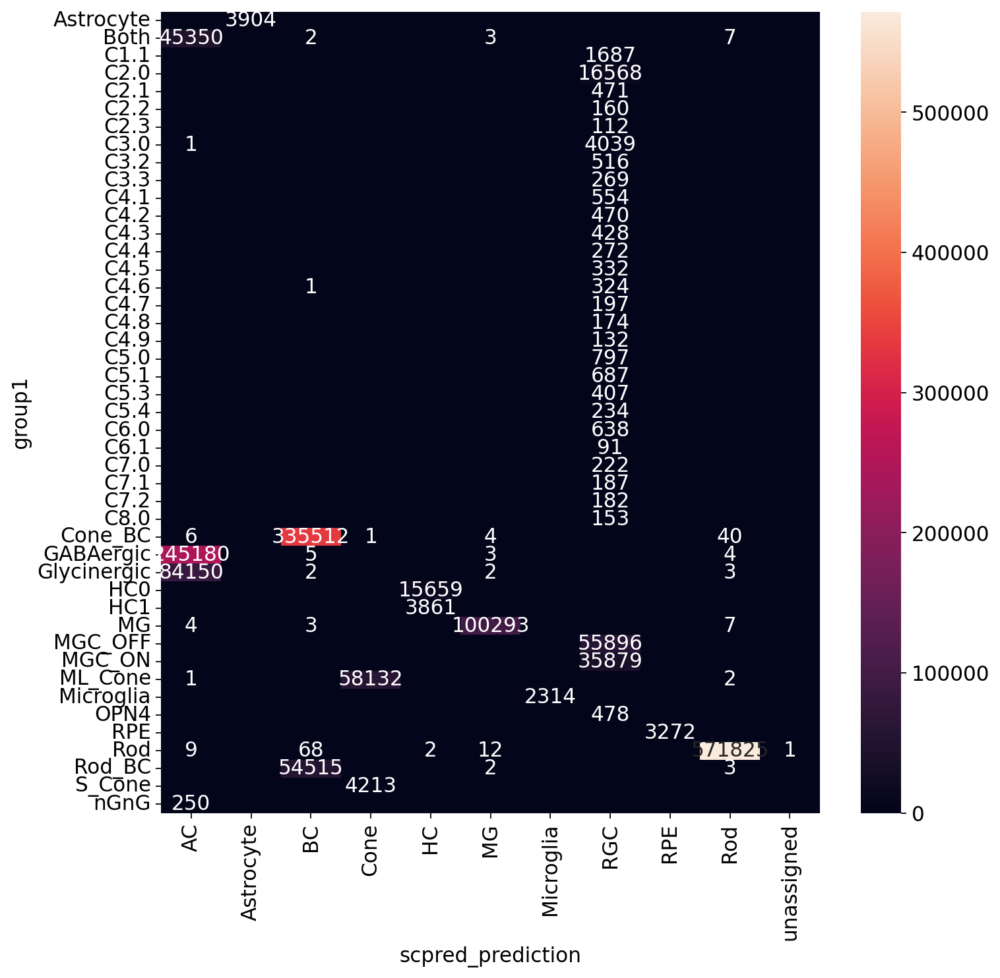

In [145]:
counts = adata_all.obs.groupby(['scpred_prediction', 'group1']).size().reset_index().pivot('scpred_prediction', 'group1', 0)
from matplotlib import rcParams
rcParams['figure.figsize'] = 10, 10
import seaborn as sns
sns.heatmap(counts.T, yticklabels=True, annot=np.where(counts.T != 0, counts.T, ''), fmt='')

In [146]:
adata_all.obs['cell_type_scarches'] = adata_all.obs['scpred_prediction'].astype(str) + ':' + adata_all.obs[cell_level_key].astype(str)
adata_all.obs['cell_type_scarches'].value_counts()

Rod:Rod                  571891
BC:BC                    390108
AC:AC                    374951
RGC:RGC                  122556
MG:MG                    100319
Cone:Cone                 62346
HC:HC                     19522
Astrocyte:Astrocyte        3904
RPE:RPE                    3272
Microglia:Microglia        2314
unassigned:unassigned         1
Name: cell_type_scarches, dtype: int64

In [147]:
adata = adata_all
# adata_all.raw
adata.X = adata.layers['counts']
print(adata.shape)
adata = remove_sparsity(adata)
print(adata.shape)


adata.obs[cell_type_key] = adata.obs['cell_type_scarches']
adata.X.max()   

(1651184, 3000)
(1651184, 3000)


1205.0

### Perform surgery on reference model and train on query dataset without cell type labels

If the cell types in 'target_adata' are equal to or a subset of the reference data cell types, one can just pass the adata without further preprocessing. It is also possible then to do semi-supervised training with scArches.

However if there are new cell types in 'target_adata' or if there is no '.obs' in the anndata for cell type labels (e.g. the data is unlabeled), one can only use scANVI in an unsupervised manner during surgery due to the nature of the classifier. 

In addition one has to preprocess 'target_adata' in the following way:

If there are new celltypes in there, save the original labels in other column and replace all labels with unlabeled category:

In [148]:
# names_by_type = None
# if names_by_type is None:
#     names_by_type = {}
#     for k in ['RGC', 'AC', 'BC']:
#         next_path = '/mnt/f/workspace/theislab/retina/data/integrated_RNA_v1/snRNA_%s_rawcounts.h5ad' % k
#         print(os.path.exists(next_path), os.path.abspath(next_path))
#         if os.path.exists(next_path):
#             ad_anno = sc.read_h5ad(next_path)
#             names_by_index = ad_anno.obs['%s_name_bymarker' % k if k != 'BC' else 'cluster2'].to_dict()
#             names_by_type[k] = names_by_index

In [149]:
# load retina data
path_to_AMD = '/mnt/f/workspace/theislab/retina/data/AMD/AMD'
import os
target_adata = sc.read_h5ad(os.path.join(path_to_AMD, 'HumanRetinaAtlas_AMD.h5ad'))
target_adata_annotations_two_samples = sc.read_h5ad(os.path.join(path_to_AMD, 'AMD_RNA_0.9.h5ad'))

In [150]:
print('here...')

here...


In [151]:
target_adata_annotations_two_samples.obs['majorclass'].value_counts()

Rod           15347
BC             4613
AC             1180
Cone            513
HC              347
RGC             162
MG              134
unassigned       87
Astrocyte        20
RPE               2
Name: majorclass, dtype: int64

In [152]:
target_adata.obs[target_adata.obs_names.str.contains('AMD1')]['sampleid']

AMD1_AAACCCAAGAATCCCT-1    Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCAAGTTCCATG-1    Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCACAACTCCAA-1    Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCACACAACCGC-1    Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCACAGGGCTTC-1    Chen_AMD_10x3_19_D18_Macular
                                       ...             
AMD1_TTTGTTGGTATACCTG-1    Chen_AMD_10x3_19_D18_Macular
AMD1_TTTGTTGGTTGAAGTA-1    Chen_AMD_10x3_19_D18_Macular
AMD1_TTTGTTGTCAGGGTAG-1    Chen_AMD_10x3_19_D18_Macular
AMD1_TTTGTTGTCGCGGTAC-1    Chen_AMD_10x3_19_D18_Macular
AMD1_TTTGTTGTCTCGGGAC-1    Chen_AMD_10x3_19_D18_Macular
Name: sampleid, Length: 11302, dtype: category
Categories (24, object): ['Chen_AMD_10x3_19_D18_Macular', 'Stambolian_GSM6173962', 'Stambolian_GSM6173964', 'Stambolian_GSM6173970', ..., 'DiStasio_GSM6841157', 'DiStasio_GSM6841159', 'Stambolian_GSM5676882', 'Stambolian_GSM5676884']

In [153]:
target_adata.obs

,DF.classifications,nCount_RNA,nFeature_RNA,pANN,percent.mt,donor,gender,age,race,medhx,disease,region,tech,accession,dataset,sampleid
AMD1_AAACCCAAGAATCCCT-1,Singlet,5229.0,2386,0.179641,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCAAGTTCCATG-1,Singlet,4704.0,2241,0.035928,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCACAACTCCAA-1,Singlet,5910.0,2497,0.005988,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCACACAACCGC-1,Singlet,7584.0,3177,0.113772,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCACAGGGCTTC-1,Singlet,4072.0,1914,0.000000,0.073674,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5676884_TTTGGTTGTCAGATTC-1,Singlet,10821.0,4228,0.071429,1.201368,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884
GSM5676884_TTTGGTTTCAACCGAT-1,Singlet,10367.0,4048,0.128571,6.549629,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884
GSM5676884_TTTGGTTTCGGTGTAT-1,Singlet,11977.0,4384,0.071429,1.803457,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884
GSM5676884_TTTGTTGCAGTGCCTG-1,Singlet,13361.0,4692,0.128571,6.893197,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884


In [154]:
len(target_adata.obs['donor'].value_counts())

17

In [155]:
target_adata.obs['donor'].value_counts()

Chen_19_D018         22515
Stambolian_0715      18334
Stambolian_0106      16998
Stambolian_0716      15263
Stambolian_0902      12956
Stambolian_0124      12893
Stambolian_0524      12747
Stambolian_0727      11983
DiStasio_A18-1974     8675
DiStasio_A20-1232     8455
DiStasio_A20-1257     7458
DiStasio_A19-2617     6222
DiStasio_A19-2161     5458
DiStasio_A1547        5358
DiStasio_G1850        4945
DiStasio_A1098        3738
DiStasio_A0233        1690
Name: donor, dtype: int64

In [156]:
target_adata.obs

,DF.classifications,nCount_RNA,nFeature_RNA,pANN,percent.mt,donor,gender,age,race,medhx,disease,region,tech,accession,dataset,sampleid
AMD1_AAACCCAAGAATCCCT-1,Singlet,5229.0,2386,0.179641,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCAAGTTCCATG-1,Singlet,4704.0,2241,0.035928,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCACAACTCCAA-1,Singlet,5910.0,2497,0.005988,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCACACAACCGC-1,Singlet,7584.0,3177,0.113772,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD1_AAACCCACAGGGCTTC-1,Singlet,4072.0,1914,0.000000,0.073674,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5676884_TTTGGTTGTCAGATTC-1,Singlet,10821.0,4228,0.071429,1.201368,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884
GSM5676884_TTTGGTTTCAACCGAT-1,Singlet,10367.0,4048,0.128571,6.549629,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884
GSM5676884_TTTGGTTTCGGTGTAT-1,Singlet,11977.0,4384,0.071429,1.803457,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884
GSM5676884_TTTGTTGCAGTGCCTG-1,Singlet,13361.0,4692,0.128571,6.893197,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884


In [157]:
target_adata.obs[target_adata.obs_names.str.contains('AMD2')]

,DF.classifications,nCount_RNA,nFeature_RNA,pANN,percent.mt,donor,gender,age,race,medhx,disease,region,tech,accession,dataset,sampleid
AMD2_AAACCCAAGAATCCCT-1,Singlet,13675.0,4779,0.128049,1.542962,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD2_AAACCCAAGATGTTGA-1,Singlet,11209.0,3887,0.371951,0.008921,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD2_AAACCCAAGCATCCCG-1,Singlet,7023.0,2866,0.012195,0.099673,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD2_AAACCCAAGCCATATC-1,Singlet,5856.0,2581,0.195122,0.017077,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD2_AAACCCAAGCTCGACC-1,Singlet,3775.0,2036,0.012195,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AMD2_TTTGTTGGTAGGAGTC-1,Singlet,3303.0,1826,0.018293,0.121102,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD2_TTTGTTGGTGGATACG-1,Singlet,4304.0,2197,0.195122,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD2_TTTGTTGGTTCGAGCC-1,Singlet,9763.0,4154,0.341463,0.184370,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular
AMD2_TTTGTTGTCCTGCCAT-1,Singlet,5592.0,2641,0.073171,0.053648,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular


In [158]:
subset_target_adata = False
n_subset = 5000
if subset_target_adata:
    is_amd1 = target_adata.obs_names.str.contains('AMD1')
    target_adata = target_adata[target_adata.obs_names.isin(pd.Series(target_adata.obs_names).sample(n_subset).values) | is_amd1,:].copy()
    print(target_adata.shape)

In [159]:
target_adata.shape

(175688, 36601)

In [160]:
# confirm that AMD1 and AMD2 are linked with "Chen_19_D018" (two samples)
target_adata_annotations_two_samples.obs['sampleid'].value_counts()

AMD1    11308
AMD2    11097
Name: sampleid, dtype: int64

In [161]:
# add the label gold_standard in cells from AMD1/2
for k in ['AMD1']: #  'AMD2']: AMD2 has mapping problems so it is ignore
    print(k, target_adata[target_adata.obs_names.str.contains(k),:].shape)
    anno_sel = target_adata_annotations_two_samples[target_adata_annotations_two_samples.obs['sampleid'] == 'AMD1',:].obs['majorclass']
    anno_sel.index = k + '_' + anno_sel.index.str[:-2]
    anno_dict = anno_sel.to_dict()
    anno_pred = target_adata.obs_names.astype('category').map(anno_dict).values
    print(pd.Series(anno_pred).value_counts())
    col_name = 'cell_type_preannotation'
    target_adata.obs[col_name] = anno_pred if not col_name in target_adata.obs else np.where(pd.isnull(target_adata.obs[col_name]), anno_pred, target_adata.obs[col_name])

    a = set(target_adata.obs_names[target_adata.obs_names.str.contains('AMD2')])
    b = anno_dict.keys()
    print(len(a.intersection(b)))

AMD1 (11302, 36601)
Rod           7505
BC            2247
AC             586
Cone           231
HC             159
RGC             72
MG              62
unassigned      38
Astrocyte        1
dtype: int64
0


In [162]:
import scanpy as sc

In [163]:
# keep raw counts in another layer, and conduct a simple cell annotation + normalization
target_adata.layers['counts'] = target_adata.X
sc.pp.normalize_per_cell(target_adata)
sc.pp.log1p(target_adata)

In [164]:
target_adata.obs['donor'].value_counts()

Chen_19_D018         22515
Stambolian_0715      18334
Stambolian_0106      16998
Stambolian_0716      15263
Stambolian_0902      12956
Stambolian_0124      12893
Stambolian_0524      12747
Stambolian_0727      11983
DiStasio_A18-1974     8675
DiStasio_A20-1232     8455
DiStasio_A20-1257     7458
DiStasio_A19-2617     6222
DiStasio_A19-2161     5458
DiStasio_A1547        5358
DiStasio_G1850        4945
DiStasio_A1098        3738
DiStasio_A0233        1690
Name: donor, dtype: int64

In [165]:
target_adata.X.max()
target_adata.X.sum(axis=0)

matrix([[1.17e+02, 4.56e+01, 5.08e-01, 5.02e+02, 1.89e+01, 7.75e-01,
         1.17e+03, ..., 1.57e+00, 6.19e-01, 0.00e+00, 1.88e+00, 8.29e+00,
         1.53e+03, 1.89e+02]], dtype=float32)

In [166]:
target_adata = target_adata[:,target_adata.X.sum(axis=0) != 0].copy()
target_adata.shape
np.any(target_adata.X.sum(axis=0) == 0), np.any(target_adata.X.sum(axis=1) == 0)

(False, False)

In [167]:
# adata_all.shape
sc.pp.highly_variable_genes(target_adata)

In [168]:
target_adata_hvg = target_adata[:,target_adata.var.highly_variable].copy()

In [169]:
sc.pp.neighbors(target_adata_hvg, method='rapids')

         Falling back to preprocessing with `sc.pp.pca` and default params.


In [170]:
target_adata_var_names = target_adata_hvg.var_names[target_adata_hvg.var_names.isin(adata.var_names)]
len(target_adata_var_names), target_adata_var_names.shape

(1738, (1738,))

In [171]:
sc.tl.umap(target_adata_hvg) #  method='rapids')


In [172]:
rcParams['figure.facecolor'] = 'white'

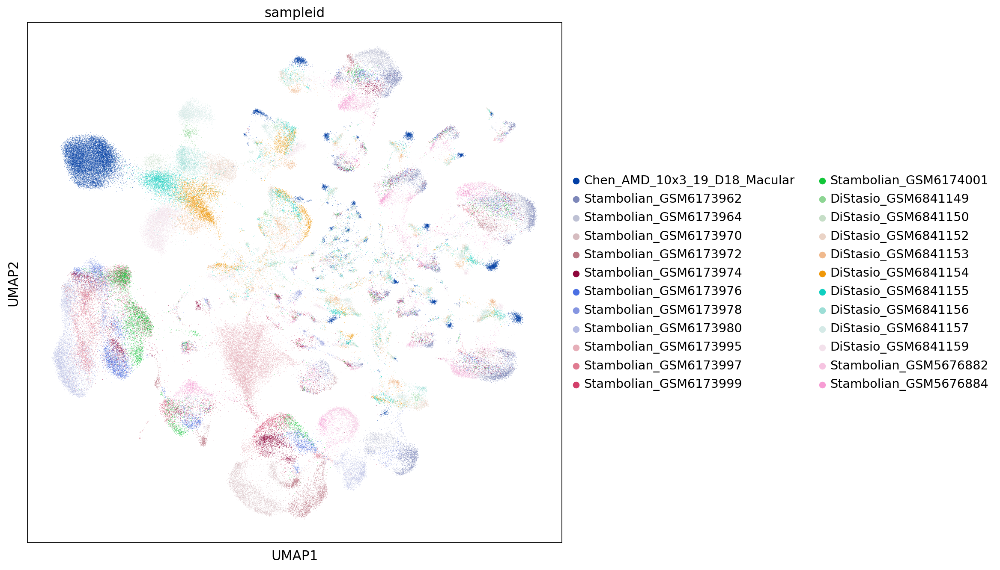

In [173]:
sc.pl.umap(target_adata_hvg, color='sampleid')

If 'target_adata' is in the right format, one can proceed with the surgery pipeline. Here we do the surgery unsupervised, but due to the overlapping cell types in query and reference data, one could also do supervised or semi-supervised surgery by setting the indices accordingly.

In [174]:
source_adata = adata[~adata.obs[condition_key].isin(target_conditions), target_adata_var_names].copy()
source_adata.shape


(1651184, 1738)

In [175]:
target_var_names = source_adata.var_names[source_adata.var_names.isin(target_adata_var_names)]
target_adata_sub = target_adata_hvg[:,target_adata_var_names].copy()
target_adata_hvg.shape, target_adata_sub.shape

((175688, 3488), (175688, 1738))

In [176]:
target_adata_sub.obs['batch_donor_dataset'] = 'AMD'

This line makes sure that count data is in the adata.X. Remember that count data in adata.X is necessary when using "nb" or "zinb" loss.

In [177]:
adata.obs[condition_key].isin(target_conditions).values, target_adata_var_names

(array([False, False, False, False, False, False, False, ..., False, False,
        False, False, False, False, False]),
 Index(['HES4', 'ISG15', 'CTNNBIP1', 'LRRC38', 'PDPN', 'KAZN', 'PADI2',
        'PLA2G5', 'ECE1', 'ID3',
        ...
        'LINC00632', 'SPANXA2-OT1', 'SLITRK2', 'AFF2', 'MAMLD1', 'CETN2',
        'SSR4', 'FLNA', 'TMLHE-AS1', 'MT-CO1'],
       dtype='object', length=1738))

In [178]:
target_adata = target_adata_hvg

In [179]:
target_adata = target_adata[:, target_adata_var_names].copy()

In [180]:
target_conditions

['nan:Roska:4']

In [181]:
source_adata.shape, target_adata.shape

((1651184, 1738), (175688, 1738))

In [182]:
source_adata.obs[condition_key].value_counts()

Chen_19_D011:Chen_a:0        122143
Chen_19_D006:Chen_a:10        95535
Chen_19_D019:Chen_a:12        81302
Chen_D013_13:Chen_a:13        75302
Chen_D005_13:Chen_a:15        61557
                              ...  
Hackney_110814:Hackney:10      8028
Chen_17D013:Chen_b:0           7942
Chen_19D014:Chen_b:5           7104
Hackney_110814:Hackney:8       6219
Hackney_110814:Hackney:9       6163
Name: batch_donor_dataset, Length: 73, dtype: int64

### Create SCANVI model and train it on fully labelled reference dataset

Preprocess reference dataset. Remember that the adata file has to have count data in adata.X for SCVI/SCANVI if not further specified

In [183]:
source_adata.obs[cell_type_key]

Chen_a_10x3_Lobe_19_D011_NeuN_s1_AAACCCAAGACATAAC-1-0:Chen_a:0    Cone:Cone
Chen_a_10x3_Lobe_19_D011_NeuN_s1_AAACCCAAGCACGTCC-1-0:Chen_a:0      Rod:Rod
Chen_a_10x3_Lobe_19_D011_NeuN_s1_AAACCCAAGCTTTCTT-1-0:Chen_a:0      Rod:Rod
Chen_a_10x3_Lobe_19_D011_NeuN_s1_AAACCCAAGGCTTAAA-1-0:Chen_a:0      Rod:Rod
Chen_a_10x3_Lobe_19_D011_NeuN_s1_AAACCCAAGTAGTCCT-1-0:Chen_a:0        HC:HC
                                                                    ...    
GSM3988016_CELL4017846-10:Hackney:10                                Rod:Rod
GSM3988016_CELL4017847-10:Hackney:10                                Rod:Rod
GSM3988016_CELL4017848-10:Hackney:10                                Rod:Rod
GSM3988016_CELL4017849-10:Hackney:10                                Rod:Rod
GSM3988016_CELL4017850-10:Hackney:10                                Rod:Rod
Name: cell_type_scarches, Length: 1651184, dtype: object

In [184]:
sca.models.SCVI.setup_anndata(source_adata, batch_key=condition_key, labels_key=cell_type_key)

# this only works in newer version
# sca.dataset.setup_anndata(source_adata, batch_key=condition_key, labels_key=cell_type_key)

In [185]:
vae = sca.models.SCVI(
    source_adata,
    n_layers=2,
    encode_covariates=True,
    deeply_inject_covariates=False,
    use_layer_norm="both",
    use_batch_norm="none",
    
)

In [186]:
n_e = 20
n_epochs_scarches = n_e
n_epochs_scanvae = n_e
n_epochs_mapping = n_e

vae.train(max_epochs=n_epochs_scarches)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 20/20: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [34:55<00:00, 101.75s/it, loss=738, v_num=1]

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [34:55<00:00, 104.77s/it, loss=738, v_num=1]


Create the SCANVI model instance with ZINB loss as default. Insert "gene_likelihood='nb'," to change the reconstruction loss to NB loss.

In [187]:
vae.history.keys()

dict_keys(['kl_weight', 'train_loss_step', 'train_loss_epoch', 'elbo_train', 'reconstruction_loss_train', 'kl_local_train', 'kl_global_train'])

Text(0, 0.5, 'train loss [epoch]')

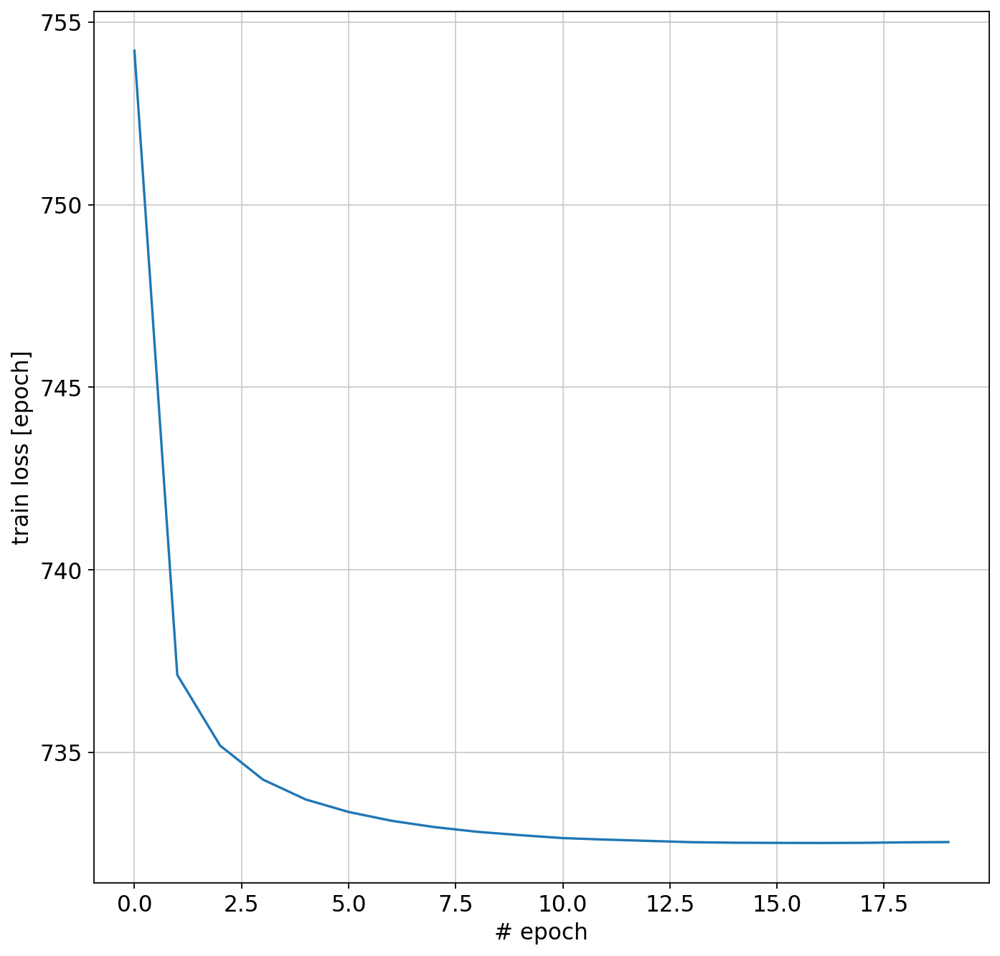

In [188]:
plt.plot(vae.history['train_loss_epoch'])
plt.xlabel('# epoch')
plt.ylabel('train loss [epoch]')

Verify that batch correction is working well through general visualization (before running scANVI)

In [189]:
latent = vae.get_latent_representation()
source_adata.obsm["X_scVI"] = latent

In [190]:
sc.pp.neighbors(source_adata, use_rep='X_scVI', method='rapids')
sc.tl.umap(source_adata)

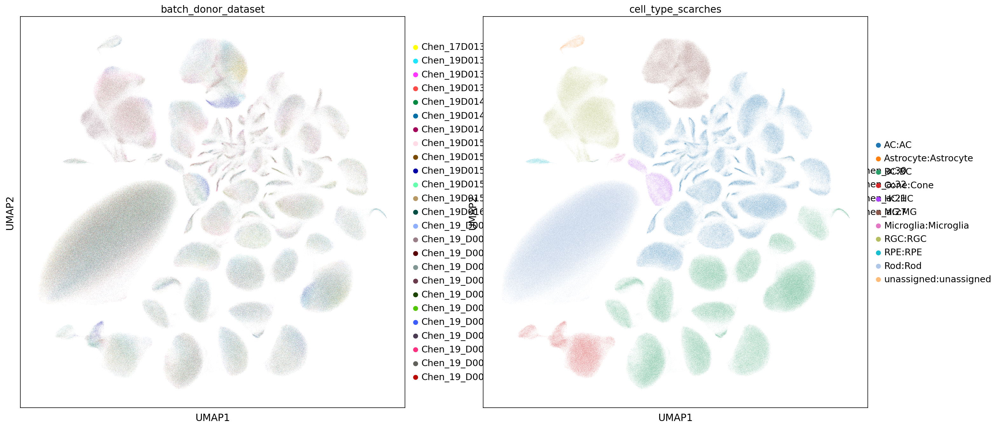

In [191]:
sc.pl.umap(source_adata, color=[condition_key, cell_type_key])

In [192]:
scanvae = sca.models.SCANVI.from_scvi_model(vae, unlabeled_category = "Unknown")

If there is no '.obs' column for cell types:

In [193]:
target_adata.obs

,DF.classifications,nCount_RNA,nFeature_RNA,pANN,percent.mt,donor,gender,age,race,medhx,disease,region,tech,accession,dataset,sampleid,cell_type_preannotation,n_counts
AMD1_AAACCCAAGAATCCCT-1,Singlet,5229.0,2386,0.179641,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,5229.0
AMD1_AAACCCAAGTTCCATG-1,Singlet,4704.0,2241,0.035928,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,4704.0
AMD1_AAACCCACAACTCCAA-1,Singlet,5910.0,2497,0.005988,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,5910.0
AMD1_AAACCCACACAACCGC-1,Singlet,7584.0,3177,0.113772,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,7584.0
AMD1_AAACCCACAGGGCTTC-1,Singlet,4072.0,1914,0.000000,0.073674,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,BC,4072.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5676884_TTTGGTTGTCAGATTC-1,Singlet,10821.0,4228,0.071429,1.201368,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,10821.0
GSM5676884_TTTGGTTTCAACCGAT-1,Singlet,10367.0,4048,0.128571,6.549629,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,10367.0
GSM5676884_TTTGGTTTCGGTGTAT-1,Singlet,11977.0,4384,0.071429,1.803457,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,11977.0
GSM5676884_TTTGTTGCAGTGCCTG-1,Singlet,13361.0,4692,0.128571,6.893197,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,13361.0


In [194]:

# assert cell_type_key in target_adata.obs
# target_adata.obs[cell_type_key] = scanvae.unlabeled_category_

In [195]:
print("Labelled Indices: ", len(scanvae._labeled_indices))
print("Unlabelled Indices: ", len(scanvae._unlabeled_indices))

Labelled Indices:  1651184
Unlabelled Indices:  0


In [196]:

scanvae.train(max_epochs=n_epochs_scanvae)

INFO     Training for 20 epochs.                                                             


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 20/20: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [1:17:07<00:00, 230.95s/it, loss=798, v_num=1]

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [1:17:07<00:00, 231.36s/it, loss=798, v_num=1]


### Create anndata file of latent representation and compute UMAP

In [197]:
source_adata.obs.columns

Index(['DF.classifications', 'nCount_RNA', 'nFeature_RNA', 'pANN',
       'percent.mt', 'scpred_prediction', 'size_factors', 'dataset',
       'filename', 'batch', 'cell.type', 'tech', 'batch.merged', 'donor',
       'batch_donor_dataset', 'group1', 'group2', 'cluster1', 'group3',
       'cell_type_scarches', '_scvi_batch', '_scvi_labels'],
      dtype='object')

In [198]:
reference_latent = sc.AnnData(scanvae.get_latent_representation())
reference_latent.obs["cell_type"] = source_adata.obs[cell_type_key].tolist()
reference_latent.obs["batch"] = source_adata.obs[condition_key].tolist()

In [199]:
sc.pp.neighbors(reference_latent, n_neighbors=8, method='rapids')
sc.tl.leiden(reference_latent)

In [200]:
reference_latent.obs

,cell_type,batch,leiden
0,Cone:Cone,Chen_19_D011:Chen_a:0,8
1,Rod:Rod,Chen_19_D011:Chen_a:0,0
2,Rod:Rod,Chen_19_D011:Chen_a:0,0
3,Rod:Rod,Chen_19_D011:Chen_a:0,7
4,HC:HC,Chen_19_D011:Chen_a:0,28
...,...,...,...
1651179,Rod:Rod,Hackney_110814:Hackney:10,12
1651180,Rod:Rod,Hackney_110814:Hackney:10,2
1651181,Rod:Rod,Hackney_110814:Hackney:10,2
1651182,Rod:Rod,Hackney_110814:Hackney:10,1


In [201]:
reference_latent.obs

,cell_type,batch,leiden
0,Cone:Cone,Chen_19_D011:Chen_a:0,8
1,Rod:Rod,Chen_19_D011:Chen_a:0,0
2,Rod:Rod,Chen_19_D011:Chen_a:0,0
3,Rod:Rod,Chen_19_D011:Chen_a:0,7
4,HC:HC,Chen_19_D011:Chen_a:0,28
...,...,...,...
1651179,Rod:Rod,Hackney_110814:Hackney:10,12
1651180,Rod:Rod,Hackney_110814:Hackney:10,2
1651181,Rod:Rod,Hackney_110814:Hackney:10,2
1651182,Rod:Rod,Hackney_110814:Hackney:10,1


In [202]:
sc.tl.umap(reference_latent)

KeyboardInterrupt: 

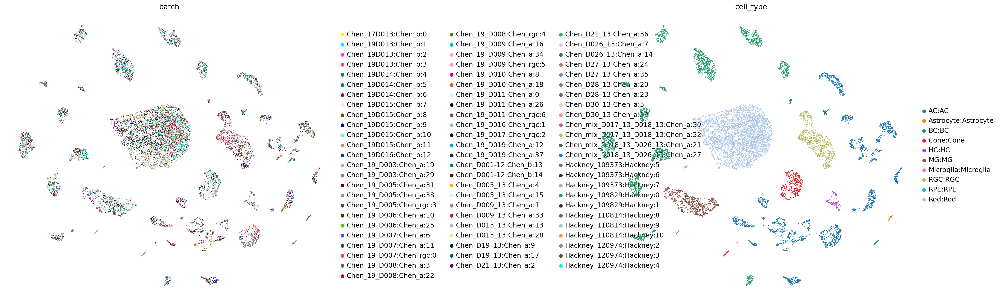

In [ ]:
rcParams['figure.facecolor'] = 'white'
sc.pl.umap(reference_latent,
           color=['batch', 'cell_type'],
           frameon=False,
           wspace=0.6,
           )

One can also compute the accuracy of the learned classifier

In [203]:
reference_latent.obs['predictions'] = scanvae.predict()
print("Acc: {}".format(np.mean(reference_latent.obs.predictions == reference_latent.obs.cell_type)))

Acc: 0.9920432853031521


After pretraining the model can be saved for later use

In [248]:
i = adata_all.shape[0]
print(i)
ref_path = 'ref_model/%s_%s/' % (dataset_code, i)
print(ref_path)

1651184
ref_model/sn_1651184/


In [249]:
scanvae.save(ref_path, overwrite=True)

In [206]:
model = sca.models.SCANVI.load_query_data(
    target_adata_sub,
    ref_path,
    freeze_dropout = True,
)
model._unlabeled_indices = np.arange(target_adata_sub.n_obs)
model._labeled_indices = []
print("Labelled Indices: ", len(model._labeled_indices))
print("Unlabelled Indices: ", len(model._unlabeled_indices))

INFO     File ref_model/sn_500000/model.pt already downloaded                                
Labelled Indices:  0
Unlabelled Indices:  175688


In [207]:

model.train(
    max_epochs=n_epochs_mapping, # 100,
    plan_kwargs=dict(weight_decay=0.0),
    check_val_every_n_epoch=10,
)

INFO     Training for 20 epochs.                                                             


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 20/20: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [10:27<00:00, 34.96s/it, loss=582, v_num=1]

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [10:27<00:00, 31.36s/it, loss=582, v_num=1]


In [208]:
query_latent = sc.AnnData(model.get_latent_representation())
query_latent.obs['cell_type'] = target_adata_sub.obs[cell_type_key].tolist()
query_latent.obs['batch'] = target_adata_sub.obs[condition_key].tolist()
query_latent.obs['cell_type_preannotation'] = target_adata_sub.obs['cell_type_preannotation'].values

In [209]:
target_adata_sub.obs

,DF.classifications,nCount_RNA,nFeature_RNA,pANN,percent.mt,donor,gender,age,race,medhx,...,tech,accession,dataset,sampleid,cell_type_preannotation,n_counts,batch_donor_dataset,_scvi_batch,cell_type_scarches,_scvi_labels
AMD1_AAACCCAAGAATCCCT-1,Singlet,5229.0,2386,0.179641,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,...,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,5229.0,AMD,73,Unknown,11
AMD1_AAACCCAAGTTCCATG-1,Singlet,4704.0,2241,0.035928,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,...,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,4704.0,AMD,73,Unknown,11
AMD1_AAACCCACAACTCCAA-1,Singlet,5910.0,2497,0.005988,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,...,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,5910.0,AMD,73,Unknown,11
AMD1_AAACCCACACAACCGC-1,Singlet,7584.0,3177,0.113772,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,...,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,7584.0,AMD,73,Unknown,11
AMD1_AAACCCACAGGGCTTC-1,Singlet,4072.0,1914,0.000000,0.073674,Chen_19_D018,Male,82,Caucasian,Unknown,...,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,BC,4072.0,AMD,73,Unknown,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5676884_TTTGGTTGTCAGATTC-1,Singlet,10821.0,4228,0.071429,1.201368,Stambolian_0902,Male,89,African,Hypertension,...,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,10821.0,AMD,73,Unknown,11
GSM5676884_TTTGGTTTCAACCGAT-1,Singlet,10367.0,4048,0.128571,6.549629,Stambolian_0902,Male,89,African,Hypertension,...,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,10367.0,AMD,73,Unknown,11
GSM5676884_TTTGGTTTCGGTGTAT-1,Singlet,11977.0,4384,0.071429,1.803457,Stambolian_0902,Male,89,African,Hypertension,...,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,11977.0,AMD,73,Unknown,11
GSM5676884_TTTGTTGCAGTGCCTG-1,Singlet,13361.0,4692,0.128571,6.893197,Stambolian_0902,Male,89,African,Hypertension,...,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,13361.0,AMD,73,Unknown,11


In [210]:
# query_latent.obs['majorclass'] = target_adata_sub.obs['majorclass'].tolist()

In [211]:
query_latent.shape

(175688, 10)

In [212]:
print('neighbors')
sc.pp.neighbors(query_latent, method='rapids')
print('leiden')
sc.tl.leiden(query_latent)

neighbors
leiden


In [213]:
print('umap')
sc.tl.umap(query_latent) #  method='rapids')

umap


In [214]:
target_adata_sub.obs

,DF.classifications,nCount_RNA,nFeature_RNA,pANN,percent.mt,donor,gender,age,race,medhx,...,tech,accession,dataset,sampleid,cell_type_preannotation,n_counts,batch_donor_dataset,_scvi_batch,cell_type_scarches,_scvi_labels
AMD1_AAACCCAAGAATCCCT-1,Singlet,5229.0,2386,0.179641,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,...,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,5229.0,AMD,73,Unknown,11
AMD1_AAACCCAAGTTCCATG-1,Singlet,4704.0,2241,0.035928,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,...,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,4704.0,AMD,73,Unknown,11
AMD1_AAACCCACAACTCCAA-1,Singlet,5910.0,2497,0.005988,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,...,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,5910.0,AMD,73,Unknown,11
AMD1_AAACCCACACAACCGC-1,Singlet,7584.0,3177,0.113772,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,...,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,7584.0,AMD,73,Unknown,11
AMD1_AAACCCACAGGGCTTC-1,Singlet,4072.0,1914,0.000000,0.073674,Chen_19_D018,Male,82,Caucasian,Unknown,...,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,BC,4072.0,AMD,73,Unknown,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5676884_TTTGGTTGTCAGATTC-1,Singlet,10821.0,4228,0.071429,1.201368,Stambolian_0902,Male,89,African,Hypertension,...,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,10821.0,AMD,73,Unknown,11
GSM5676884_TTTGGTTTCAACCGAT-1,Singlet,10367.0,4048,0.128571,6.549629,Stambolian_0902,Male,89,African,Hypertension,...,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,10367.0,AMD,73,Unknown,11
GSM5676884_TTTGGTTTCGGTGTAT-1,Singlet,11977.0,4384,0.071429,1.803457,Stambolian_0902,Male,89,African,Hypertension,...,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,11977.0,AMD,73,Unknown,11
GSM5676884_TTTGTTGCAGTGCCTG-1,Singlet,13361.0,4692,0.128571,6.893197,Stambolian_0902,Male,89,African,Hypertension,...,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,13361.0,AMD,73,Unknown,11


In [215]:
target_adata.obs['cell_type_preannotation'].value_counts()

Rod           7505
BC            2247
AC             586
Cone           231
HC             159
RGC             72
MG              62
unassigned      38
Astrocyte        1
Name: cell_type_preannotation, dtype: int64

In [216]:
query_latent.obs['cell_type_preannotation'].value_counts()

Rod           7505
BC            2247
AC             586
Cone           231
HC             159
RGC             72
MG              62
unassigned      38
Astrocyte        1
Name: cell_type_preannotation, dtype: int64

<Figure size 800x800 with 0 Axes>

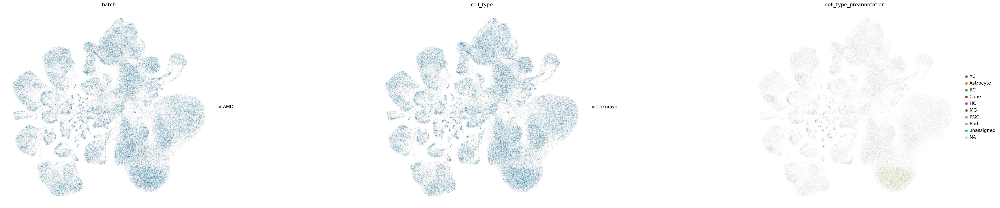

In [217]:
rcParams['figure.facecolor'] = 'white'
plt.figure()
sc.pl.umap(
    query_latent,
    color=["batch", "cell_type", 'cell_type_preannotation'], #  'majorclass'],
    frameon=False,
    wspace=0.6,
)

In [218]:
surgery_path = 'surgery_model'
model.save(surgery_path, overwrite=True)

## Uncertainties

Based on
https://docs.scvi-tools.org/en/stable/tutorials/notebooks/query_hlca_knn.html#Loading-the-query-model-from-the-reference-files

In [219]:
import pynndescent
X_train = reference_latent.X # adata.obsm["_scanvi_latent_qzm"]
ref_nn_index = pynndescent.NNDescent(X_train)
ref_nn_index.prepare()

In [220]:
ref_neighbors, ref_distances = ref_nn_index.query(query_latent.X)


In [221]:
import numba

In [222]:
adata.obs['cell_type_scarches'] = adata.obs['cell_type_scarches'].astype('category')

In [223]:

# convert distances to affinities
stds = np.std(ref_distances, axis=1)
stds = (2.0 / stds) ** 2
stds = stds.reshape(-1, 1)
ref_distances_tilda = np.exp(-np.true_divide(ref_distances, stds))
weights = ref_distances_tilda / np.sum(ref_distances_tilda, axis=1, keepdims=True)


@numba.njit
def weighted_prediction(weights, ref_cats):
    """Get highest weight category."""
    N = len(weights)
    predictions = np.zeros((N,), dtype=ref_cats.dtype)
    uncertainty = np.zeros((N,))
    for i in range(N):
        obs_weights = weights[i]
        obs_cats = ref_cats[i]
        best_prob = 0
        for c in np.unique(obs_cats):
            cand_prob = np.sum(obs_weights[obs_cats == c])
            if cand_prob > best_prob:
                best_prob = cand_prob
                predictions[i] = c
                uncertainty[i] = max(1 - best_prob, 0)

    return predictions, uncertainty


# for each annotation level, get prediction and uncertainty
# label_keys = [f"ann_level_{i}" for i in range(1, 6)] + ["ann_finest_level"]
label_keys = ['cell_type_scarches']
for l in label_keys:
    ref_cats = adata.obs[l].cat.codes.to_numpy()[ref_neighbors]
    p, u = weighted_prediction(weights, ref_cats)
    p = np.asarray(adata.obs[l].cat.categories)[p]
    query_latent.obs[l + "_pred"], query_latent.obs[l + "_uncertainty"] = p, u

In [224]:
import seaborn as sns

In [225]:
matched_pred = query_latent.obs.copy() # [query_latent.obs.majorclass.astype(str) == query_latent.obs.cell_type_pred.astype(str)]

In [226]:
matched_pred.batch.value_counts()

AMD    175688
Name: batch, dtype: int64

In [227]:
matched_pred

,cell_type,batch,cell_type_preannotation,leiden,cell_type_scarches_pred,cell_type_scarches_uncertainty
0,Unknown,AMD,Rod,0,Rod:Rod,0.0
1,Unknown,AMD,Rod,0,Rod:Rod,0.0
2,Unknown,AMD,Rod,0,Rod:Rod,0.0
3,Unknown,AMD,Rod,0,Rod:Rod,0.0
4,Unknown,AMD,BC,11,BC:BC,0.0
...,...,...,...,...,...,...
175683,Unknown,AMD,NaN,8,MG:MG,0.0
175684,Unknown,AMD,NaN,6,BC:BC,0.0
175685,Unknown,AMD,NaN,8,MG:MG,0.0
175686,Unknown,AMD,NaN,7,BC:BC,0.0


In [228]:

# matched_pred_sample = matched_pred.sample(100)
matched_pred_sample = matched_pred
uncert_labels = matched_pred_sample.groupby('cell_type_scarches_pred').mean().sort_values('cell_type_scarches_uncertainty',
                                                                                          ascending=False).index

In [229]:
s = matched_pred_sample['cell_type_scarches_uncertainty']
s_norm = (s - s.min()) / (s.max() - s.min())
matched_pred_sample['cell_type_scarches_uncertainty_norm'] = s_norm

In [230]:
s_norm.describe()

count    1.756880e+05
mean     1.231774e-02
std      7.387966e-02
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      8.511142e-08
max      1.000000e+00
Name: cell_type_scarches_uncertainty, dtype: float64

In [231]:
matched_pred.shape, target_adata.shape

((175688, 7), (175688, 1738))

In [232]:
for c in target_adata.obs:
    print(c)
    matched_pred[c] = target_adata.obs[c].values

DF.classifications
nCount_RNA
nFeature_RNA
pANN
percent.mt
donor
gender
age
race
medhx
disease
region
tech
accession
dataset
sampleid
cell_type_preannotation
n_counts


In [233]:
i = adata_all.shape[0]
output_basename = 'scanvi_query_to_reference_%s_subset_%i_%i_%s' % (dataset_code, use_subset, i, cell_level_key)

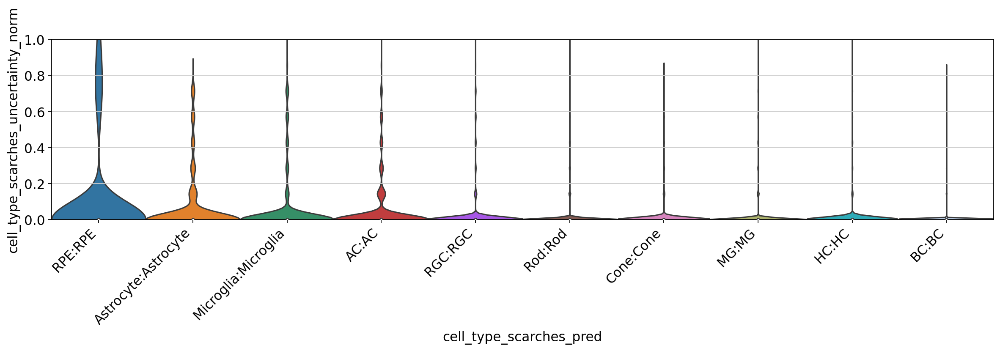

In [234]:
rcParams['figure.figsize'] = 15, 5
rcParams['figure.dpi'] = 80

sns.violinplot(data=matched_pred_sample,
               x='cell_type_scarches_pred',
               y='cell_type_scarches_uncertainty_norm',
               order=uncert_labels,
               width=1.0, linewidth=1.4,
               scale='width', cut=1.0)
plt.xticks(rotation=45, ha='right');
plt.ylim([0, 1])

i = source_adata.shape[0]
plt.tight_layout()
plt.savefig('%s.pdf' % (output_basename))
plt.show()

matched_pred_sample.to_csv('%s.tsv.gz' % (output_basename))


### Compute Accuracy of model classifier for query dataset and compare predicted and observed cell types

In [235]:
query_latent.obs['sample_id'] = target_adata.obs['sampleid'].values
query_latent.obs['obs_names'] = target_adata.obs_names
query_latent.obs

,cell_type,batch,cell_type_preannotation,leiden,cell_type_scarches_pred,cell_type_scarches_uncertainty,sample_id,obs_names
0,Unknown,AMD,Rod,0,Rod:Rod,0.0,Chen_AMD_10x3_19_D18_Macular,AMD1_AAACCCAAGAATCCCT-1
1,Unknown,AMD,Rod,0,Rod:Rod,0.0,Chen_AMD_10x3_19_D18_Macular,AMD1_AAACCCAAGTTCCATG-1
2,Unknown,AMD,Rod,0,Rod:Rod,0.0,Chen_AMD_10x3_19_D18_Macular,AMD1_AAACCCACAACTCCAA-1
3,Unknown,AMD,Rod,0,Rod:Rod,0.0,Chen_AMD_10x3_19_D18_Macular,AMD1_AAACCCACACAACCGC-1
4,Unknown,AMD,BC,11,BC:BC,0.0,Chen_AMD_10x3_19_D18_Macular,AMD1_AAACCCACAGGGCTTC-1
...,...,...,...,...,...,...,...,...
175683,Unknown,AMD,NaN,8,MG:MG,0.0,Stambolian_GSM5676884,GSM5676884_TTTGGTTGTCAGATTC-1
175684,Unknown,AMD,NaN,6,BC:BC,0.0,Stambolian_GSM5676884,GSM5676884_TTTGGTTTCAACCGAT-1
175685,Unknown,AMD,NaN,8,MG:MG,0.0,Stambolian_GSM5676884,GSM5676884_TTTGGTTTCGGTGTAT-1
175686,Unknown,AMD,NaN,7,BC:BC,0.0,Stambolian_GSM5676884,GSM5676884_TTTGTTGCAGTGCCTG-1


<AxesSubplot:xlabel='cell_type_preannotation', ylabel='sample_id'>

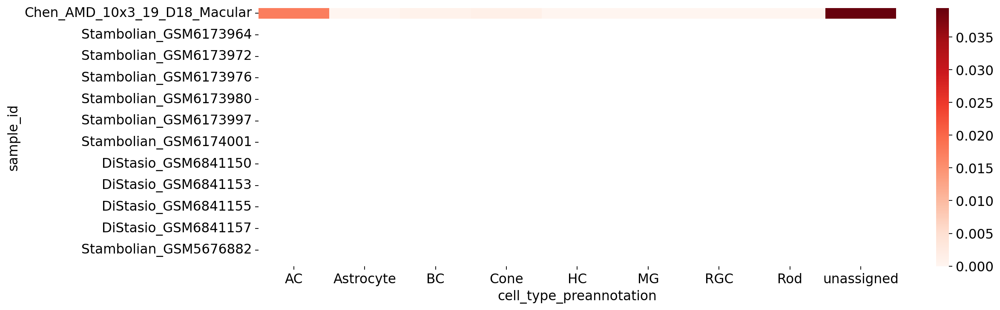

In [236]:
uncert = query_latent.obs.groupby(['sample_id', 'cell_type_preannotation']).mean().reset_index().pivot('sample_id',
                                                                                              'cell_type_preannotation',
                                                                                              'cell_type_scarches_uncertainty')

sns.heatmap(uncert, cmap='Reds')

In [237]:
query_latent.obs.to_csv('../../data/AMD_query_uncertainties_20230724.csv.gz')

In [238]:
query_latent.obs['cell_type_preannotation'].value_counts()

Rod           7505
BC            2247
AC             586
Cone           231
HC             159
RGC             72
MG              62
unassigned      38
Astrocyte        1
Name: cell_type_preannotation, dtype: int64

In [239]:
query_latent.obs['predictions'] = model.predict()
has_preannotation = ~pd.isnull(query_latent.obs['cell_type_preannotation'])
pred = query_latent.obs.predictions[has_preannotation].str.split(':').str[0]
true = query_latent.obs.cell_type_preannotation[has_preannotation]
print("Acc: {}".format(np.mean(pred == true)))

Acc: 0.9960554077607559


In [240]:
query_latent[has_preannotation].obs

,cell_type,batch,cell_type_preannotation,leiden,cell_type_scarches_pred,cell_type_scarches_uncertainty,sample_id,obs_names,predictions
0,Unknown,AMD,Rod,0,Rod:Rod,0.000000e+00,Chen_AMD_10x3_19_D18_Macular,AMD1_AAACCCAAGAATCCCT-1,Rod:Rod
1,Unknown,AMD,Rod,0,Rod:Rod,0.000000e+00,Chen_AMD_10x3_19_D18_Macular,AMD1_AAACCCAAGTTCCATG-1,Rod:Rod
2,Unknown,AMD,Rod,0,Rod:Rod,0.000000e+00,Chen_AMD_10x3_19_D18_Macular,AMD1_AAACCCACAACTCCAA-1,Rod:Rod
3,Unknown,AMD,Rod,0,Rod:Rod,0.000000e+00,Chen_AMD_10x3_19_D18_Macular,AMD1_AAACCCACACAACCGC-1,Rod:Rod
4,Unknown,AMD,BC,11,BC:BC,0.000000e+00,Chen_AMD_10x3_19_D18_Macular,AMD1_AAACCCACAGGGCTTC-1,BC:BC
...,...,...,...,...,...,...,...,...,...
11297,Unknown,AMD,Rod,3,Rod:Rod,0.000000e+00,Chen_AMD_10x3_19_D18_Macular,AMD1_TTTGTTGGTATACCTG-1,Rod:Rod
11298,Unknown,AMD,BC,18,BC:BC,0.000000e+00,Chen_AMD_10x3_19_D18_Macular,AMD1_TTTGTTGGTTGAAGTA-1,BC:BC
11299,Unknown,AMD,BC,24,BC:BC,0.000000e+00,Chen_AMD_10x3_19_D18_Macular,AMD1_TTTGTTGTCAGGGTAG-1,BC:BC
11300,Unknown,AMD,Rod,0,Rod:Rod,1.192093e-07,Chen_AMD_10x3_19_D18_Macular,AMD1_TTTGTTGTCGCGGTAC-1,Rod:Rod


<Figure size 800x400 with 0 Axes>

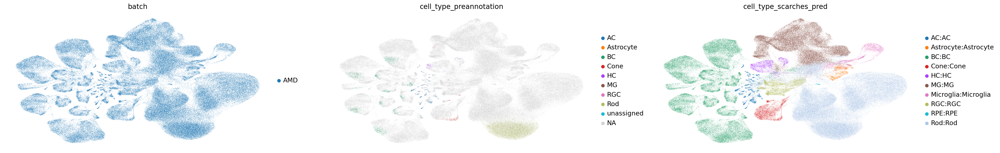

In [241]:
rcParams['figure.facecolor'] = 'white'
rcParams['figure.facecolor'] = 'white'
rcParams['figure.figsize'] = 10, 5
plt.figure()
sc.pl.umap(
    query_latent,
    color=["batch", "cell_type_preannotation", 'cell_type_scarches_pred'],
    frameon=False,
    wspace=0.1,
)

/tmp/ipykernel_819/1572848659.py:5: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  _ = plt.pcolor(norm_df)


Text(0, 0.5, 'Observed')

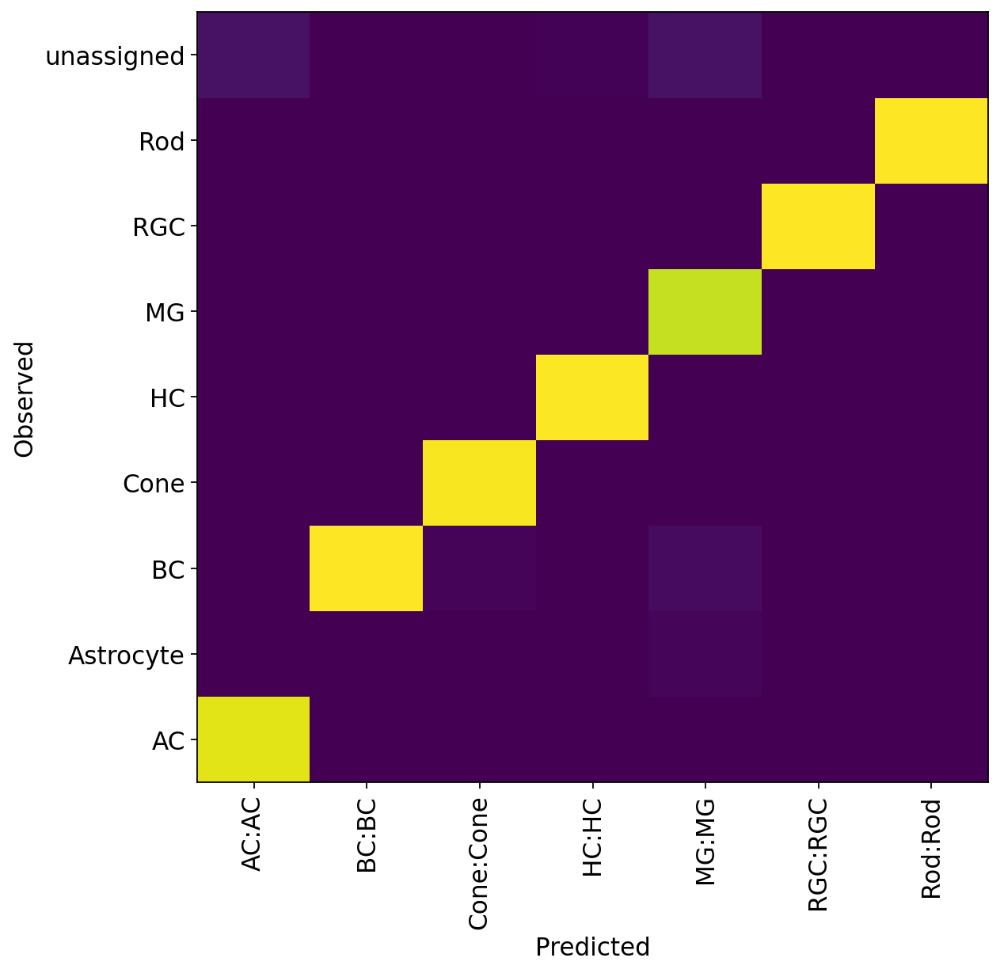

In [242]:
df = query_latent.obs.groupby(["cell_type_preannotation", "predictions"]).size().unstack(fill_value=0)
norm_df = df / df.sum(axis=0)

plt.figure(figsize=(8, 8))
_ = plt.pcolor(norm_df)
_ = plt.xticks(np.arange(0.5, len(df.columns), 1), df.columns, rotation=90)
_ = plt.yticks(np.arange(0.5, len(df.index), 1), df.index)
plt.xlabel("Predicted")
plt.ylabel("Observed")

### Get latent representation of reference + query dataset and compute UMAP

In [243]:
# adata_full.obs['cell_type_preannotation']

In [250]:
adata_full = source_adata.concatenate(target_adata_sub)
full_latent = sc.AnnData(model.get_latent_representation(adata=adata_full))
full_latent.obs['cell_type'] = adata_full.obs[cell_type_key].tolist()
full_latent.obs['batch'] = adata_full.obs[condition_key].tolist()
full_latent.obs['cell_type_preannotation'] = adata_full.obs['cell_type_preannotation'].tolist()

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


In [251]:
print('nn')
sc.pp.neighbors(full_latent, method='rapids')
print('leiden')
sc.tl.leiden(full_latent)
print('umap')
sc.tl.umap(full_latent)

nn
leiden
umap


In [ ]:
full_latent.obs['type'] = np.where(full_latent.obs['batch'].str.contains("AMD"), 'query', 'reference')

<Figure size 800x400 with 0 Axes>

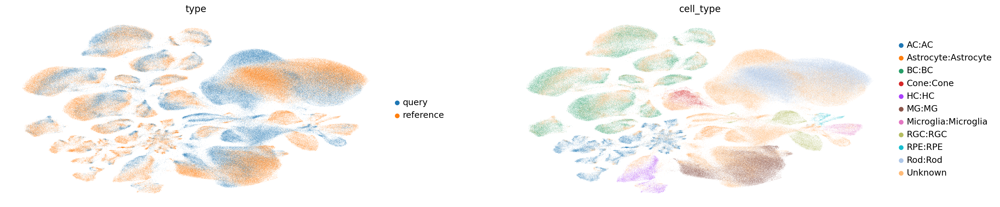

In [ ]:
rcParams['figure.figsize'] = 10, 5
plt.figure()
sc.pl.umap(
    full_latent,
    color=["type", "cell_type"],
    frameon=False,
    wspace=0.2,
)

### Comparison of observed and predicted celltypes for reference + query dataset

In [ ]:
full_latent.obs['predictions'] = model.predict(adata=adata_full)

In [ ]:
is_amd1 = ~pd.isnull(full_latent.obs['cell_type_preannotation']).values

y_pred = full_latent.obs.predictions[is_amd1].astype(str).astype(str).str.split(':').str[0].values
y_true = full_latent.obs.cell_type_preannotation[is_amd1].astype(str).str.split(':').str[0].values
print("Acc: {}".format(np.mean(y_pred == y_true)))

Acc: 0.9960554077607559


In [ ]:
df = pd.DataFrame()
df['true'] = y_true
df['pred'] = y_pred
df['true'].value_counts()

Rod           7505
BC            2247
AC             586
Cone           231
HC             159
RGC             72
MG              62
unassigned      38
Astrocyte        1
Name: true, dtype: int64

In [ ]:
full_latent.obs['batch']

0         Roska_R-00646_01:Roska:0
1         Roska_R-00646_01:Roska:0
2         Roska_R-00646_01:Roska:0
3         Roska_R-00646_01:Roska:0
4         Roska_R-00646_01:Roska:0
                    ...           
441339                         AMD
441340                         AMD
441341                         AMD
441342                         AMD
441343                         AMD
Name: batch, Length: 441344, dtype: category
Categories (52, object): ['AMD', 'Hafler_555:Hafler:0', 'Hafler_555:Hafler:1', 'Hafler_574:Hafler:2', ..., 'Wong_Donor_2:Wong:1', 'Wong_Donor_2:Wong:2', 'Wong_Donor_3:Wong:3', 'Wong_Donor_3:Wong:4']

In [ ]:
sc.pp.neighbors(full_latent)
sc.tl.leiden(full_latent)
sc.tl.umap(full_latent)

In [ ]:
full_latent.obs['predictions'],full_latent.obs['cell_type']

(0         Rod:Rod
 1           MG:MG
 2           MG:MG
 3           BC:BC
 4         Rod:Rod
            ...   
 441339      MG:MG
 441340      BC:BC
 441341      MG:MG
 441342      BC:BC
 441343      MG:MG
 Name: predictions, Length: 441344, dtype: object,
 0         Rod:Rod
 1           MG:MG
 2           MG:MG
 3           BC:BC
 4         Rod:Rod
            ...   
 441339    Unknown
 441340    Unknown
 441341    Unknown
 441342    Unknown
 441343    Unknown
 Name: cell_type, Length: 441344, dtype: category
 Categories (11, object): ['AC:AC', 'Astrocyte:Astrocyte', 'BC:BC', 'Cone:Cone', ..., 'RGC:RGC', 'RPE:RPE', 'Rod:Rod', 'Unknown'])

<Figure size 750x750 with 0 Axes>

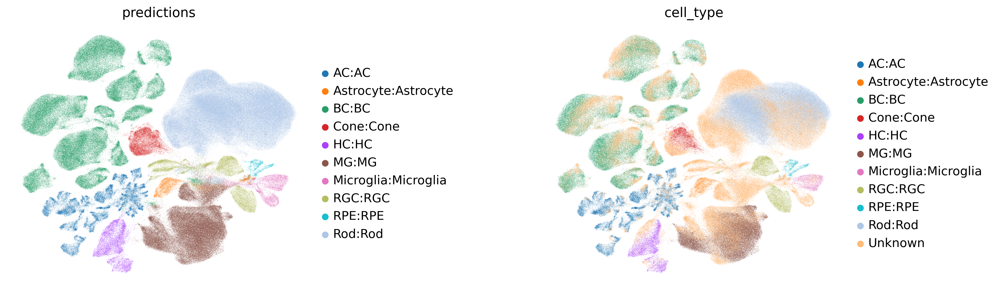

In [ ]:
rcParams['figure.figsize'] = 5,5
rcParams['figure.dpi'] = 150
plt.figure()
sc.pl.umap(
    full_latent,
    color=["predictions", "cell_type"],
    frameon=False,
    wspace=0.6,
)

In [ ]:
target_adata.obs

,DF.classifications,nCount_RNA,nFeature_RNA,pANN,percent.mt,donor,gender,age,race,medhx,disease,region,tech,accession,dataset,sampleid,cell_type_preannotation,n_counts
AMD1_AAACCCAAGAATCCCT-1,Singlet,5229.0,2386,0.179641,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,5229.0
AMD1_AAACCCAAGTTCCATG-1,Singlet,4704.0,2241,0.035928,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,4704.0
AMD1_AAACCCACAACTCCAA-1,Singlet,5910.0,2497,0.005988,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,5910.0
AMD1_AAACCCACACAACCGC-1,Singlet,7584.0,3177,0.113772,0.000000,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,Rod,7584.0
AMD1_AAACCCACAGGGCTTC-1,Singlet,4072.0,1914,0.000000,0.073674,Chen_19_D018,Male,82,Caucasian,Unknown,IntermediateAMD(AREDS3),Macular,single_nuclei,private,Chen_AMD,Chen_AMD_10x3_19_D18_Macular,BC,4072.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5676884_TTTGGTTGTCAGATTC-1,Singlet,10821.0,4228,0.071429,1.201368,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,10821.0
GSM5676884_TTTGGTTTCAACCGAT-1,Singlet,10367.0,4048,0.128571,6.549629,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,10367.0
GSM5676884_TTTGGTTTCGGTGTAT-1,Singlet,11977.0,4384,0.071429,1.803457,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,11977.0
GSM5676884_TTTGTTGCAGTGCCTG-1,Singlet,13361.0,4692,0.128571,6.893197,Stambolian_0902,Male,89,African,Hypertension,EarlyAMD,Periphery,single_cell,GSE188280,Stambolian,Stambolian_GSM5676884,NaN,13361.0


In [ ]:
target_adata.shape

(175688, 1678)